<a href="https://colab.research.google.com/github/shoopy7/shoopy7/blob/main/KaggleMoviesDatasetForFeatureExtractionPredictionNtbk.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load libraries

In [2]:
#Libraries to help with reading and manipulating data
import pandas as pd
import numpy as np

# libaries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns
#import plotly.express as px #3d interactive graphs can save as html and put on websites

# Removes the limit for the number of displayed columns
pd.set_option("display.max_columns", None)
# Sets the limit for the number of displayed rows
pd.set_option("display.max_rows", 200)
# To supress scientific notations for a dataframe
pd.set_option("display.float_format", lambda x: "%.3f" % x)


#Load and copy data set and mount Google drive

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
# load data set
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/data sets/KaggleMoviesDataSet/movies.csv')

In [5]:
# copying data to another varaible to avoid any changes to original data
df = data.copy()

#data overview, sanity checks, statistical summary, observations

##overview

In [6]:
df.shape

(9999, 9)

In [7]:
df.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime,Gross
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.100,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.000,NaN
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.000,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.000,NaN
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.200,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.000,NaN
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.200,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.000,NaN
4,Army of Thieves,(2021),"\nAction, Crime, Horror",NaN,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN,NaN


In [8]:
df.tail()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime,Gross
9994,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",NaN,\nAdd a Plot\n,\n \n Stars:\nMorgan Taylor Camp...,NaN,NaN,NaN
9995,Arcane,(2021– ),"\nAnimation, Action, Adventure",NaN,\nAdd a Plot\n,\n,NaN,NaN,NaN
9996,Heart of Invictus,(2022– ),"\nDocumentary, Sport",NaN,\nAdd a Plot\n,\n Director:\nOrlando von Einsiedel\n| \n ...,NaN,NaN,NaN
9997,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",NaN,\nAdd a Plot\n,\n Director:\nJovanka Vuckovic\n| \n Sta...,NaN,NaN,NaN
9998,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",NaN,\nAdd a Plot\n,\n Director:\nJovanka Vuckovic\n| \n Sta...,NaN,NaN,NaN


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   MOVIES    9999 non-null   object 
 1   YEAR      9355 non-null   object 
 2   GENRE     9919 non-null   object 
 3   RATING    8179 non-null   float64
 4   ONE-LINE  9999 non-null   object 
 5   STARS     9999 non-null   object 
 6   VOTES     8179 non-null   object 
 7   RunTime   7041 non-null   float64
 8   Gross     460 non-null    object 
dtypes: float64(2), object(7)
memory usage: 703.2+ KB


We see a lot of possible cleaning options we can apply to the data set.

In [10]:
# standardize the column names

# Function to clean column names
def clean_column_names(df):
    df.columns = (df.columns
                  .str.lower()  # Convert to lowercase
                  .str.replace(r'[^\w\s]', '', regex=True)  # Remove punctuation
                  .str.replace(r'\s+', '_', regex=True)  # Replace spaces with underscores
                  .str.rstrip('_'))  # Remove trailing underscores
    return df

# Apply the function
df = clean_column_names(df)

# Print cleaned column names
print(df.columns)


Index(['movies', 'year', 'genre', 'rating', 'oneline', 'stars', 'votes',
       'runtime', 'gross'],
      dtype='object')


Examine each column and apply cleaning appropriate to the data.

In [11]:
# remove \n from the beginning of the values in the 'genre' column
df['genre'] = df['genre'].str.lstrip('\n')
# remove \n from the beginning of the values in the 'oneline' column
df['oneline'] = df['oneline'].str.lstrip('\n')
# remove \n from the values in the 'stars' and 'oneline'column
df['stars'] = df['stars'].str.replace('\n', '', regex=True)
df['oneline'] = df['oneline'].str.replace('\n', '', regex=True)
# removes commas from 'votes' numbers
df['votes'] = df['votes'].str.replace(',', '', regex=True)

In [12]:
# Convert to numeric (float)
df['votes'] = pd.to_numeric(df['votes'], errors='coerce')

# Check the data types
print(df.dtypes)

movies      object
year        object
genre       object
rating     float64
oneline     object
stars       object
votes      float64
runtime    float64
gross       object
dtype: object


In [13]:
# check how many values are listed in the 'genre' cell to separate into cols below
df['genre'].str.count(', ').max()


2.0

With 2 commas max in the 'genre' column, I know that 3 separate genre columns are the most needed.

In [14]:
# split the multiple values within the 'genre' column into separate columns
genre_split = df['genre'].str.split(', ', expand=True)
genre_split.columns = ['genre1', 'genre2', 'genre3']  # Rename columns
df = df.join(genre_split)  # Add new genre columns to the original dataframe

# Replace 'none' with NaN
df.replace('none', np.nan, inplace=True)

In [15]:
#verify changes
df.head(2)

,movies,year,genre,rating,oneline,stars,votes,runtime,gross,genre1,genre2,genre3
0,Blood Red Sky,(2021),"Action, Horror, Thriller",6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,NaN,Action,Horror,Thriller
1,Masters of the Universe: Revelation,(2021– ),"Animation, Action, Adventure",5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,NaN,Animation,Action,Adventure


In [16]:
# check entries, to list all rows
pd.set_option('display.max_rows', None)

In [17]:
# view all rows to check before dropping 'genre' column
df[['movies','genre','genre1','genre2','genre3']]

,movies,genre,genre1,genre2,genre3
0,Blood Red Sky,"Action, Horror, Thriller",Action,Horror,Thriller
1,Masters of the Universe: Revelation,"Animation, Action, Adventure",Animation,Action,Adventure
2,The Walking Dead,"Drama, Horror, Thriller",Drama,Horror,Thriller
3,Rick and Morty,"Animation, Adventure, Comedy",Animation,Adventure,Comedy
4,Army of Thieves,"Action, Crime, Horror",Action,Crime,Horror
5,Outer Banks,"Action, Crime, Drama",Action,Crime,Drama
6,The Last Letter from Your Lover,"Drama, Romance",Drama,Romance,None
7,Dexter,"Crime, Drama, Mystery",Crime,Drama,Mystery
8,Never Have I Ever,Comedy,Comedy,None,None
9,Virgin River,"Drama, Romance",Drama,Romance,None


In [18]:
# checking on duplicates
#  total number of duplicate rows
df.duplicated().sum()

431

In [19]:
# count dups based on specific cols
df['movies'].value_counts()

,count
movies,
Bleach: Burîchi,65
Mighty Little Bheem,64
Avatar: The Last Airbender,61
La Reina de Indias y el Conquistador,60
Dexter,48
The Drew Barrymore Show,45
Power Rangers: Dino Fury,44
Power Rangers Beast Morphers,40
Johnny Test,39


In [ ]:
# #display only the duplicate rows
# df[df.duplicated()]

In [ ]:
# #to see all instances of duplicates (including the first occurrence), use:
# df[df.duplicated(keep=False)]

In [20]:
# Check for duplicates based on specific columns
df[df.duplicated(subset=['movies'], keep=False)]

,movies,year,genre,rating,oneline,stars,votes,runtime,gross,genre1,genre2,genre3
34,Kingdom,(2019– ),"Action, Drama, History",8.400,While strange rumors about their ill King grip...,"Stars:Ju Ji-Hoon, Bae Doona, K...",34906.000,45.000,NaN,Action,Drama,History
129,Avatar: The Last Airbender,(2005–2008),"Animation, Action, Adventure",9.300,"In a war-torn world of elemental magic, a youn...","Stars:Dee Bradley Baker, Zach ...",265845.000,23.000,NaN,Animation,Action,Adventure
139,Heist,(2021– ),"Documentary, Crime, Mystery",6.800,Millions in stolen cash. Missing luxury bourbo...,"Stars:William Guirola, Megan B...",846.000,41.000,NaN,Documentary,Crime,Mystery
177,Snowpiercer,(2020– ),"Action, Drama, Sci-Fi",6.900,Seven years after the world has become a froze...,"Stars:Daveed Diggs, Iddo Goldb...",39433.000,60.000,NaN,Action,Drama,Sci-Fi
235,Sexy Beasts,(2021– ),"Reality-TV, Romance",4.700,"Hoping to say goodbye to superficial dating, r...",Star:Rob Delaney,592.000,NaN,NaN,Reality-TV,Romance,None
247,Hagane no renkinjutsushi,(2009–2012),"Animation, Action, Adventure",9.100,Two brothers search for a Philosopher's Stone ...,"Stars:Kent Williams, Iemasa Ka...",134855.000,24.000,NaN,Animation,Action,Adventure
254,Revenge,(2011–2015),"Drama, Mystery, Thriller",7.800,An emotionally troubled young woman sets out t...,"Stars:Madeleine Stowe, Emily V...",114932.000,44.000,NaN,Drama,Mystery,Thriller
309,Snowpiercer,(2013),"Action, Drama, Sci-Fi",7.100,In a future where a failed climate-change expe...,Director:Bong Joon Ho| Stars:Chris Eva...,335946.000,126.000,$4.56M,Action,Drama,Sci-Fi
329,Beauty and the Beast,(I) (2017),"Family, Fantasy, Musical",7.100,A selfish Prince is cursed to become a monster...,Director:Bill Condon| Stars:Emma Watso...,284484.000,129.000,$504.01M,Family,Fantasy,Musical
334,Bodyguard,(2018),"Crime, Drama, Thriller",8.100,A contemporary thriller featuring the Royalty ...,"Stars:Richard Madden, Sophie R...",103187.000,60.000,NaN,Crime,Drama,Thriller


In [21]:
# # Drop duplicates if needed
# df.drop_duplicates(inplace=True)
# drop duplicates only based on the movies column, keeping the first occurrence:
df.drop_duplicates(subset=['movies'], keep='first', inplace=True)
df.reset_index(drop=True, inplace=True)


In [22]:
# verify chagnes
#  total number of duplicate rows
df.duplicated().sum()

0

In [23]:
df.shape

(6817, 12)

Duplicates have been dropped (except for the first occurence of the movie).  This reduced the number of observations from the original set of 9999 to 6817.

In [24]:
# drop original 'genre' cell with multiple values in the same cell
df.drop(columns='genre', inplace=True)

# verify changes
df.head(2)

,movies,year,rating,oneline,stars,votes,runtime,gross,genre1,genre2,genre3
0,Blood Red Sky,(2021),6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,NaN,Action,Horror,Thriller
1,Masters of the Universe: Revelation,(2021– ),5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,NaN,Animation,Action,Adventure


The genre column has been split into 3 columns, so we dropped the original genre column with multiple values in the same cell.

In [25]:
# count how many rows have 'tv' in the date column
df[df['year'].str.contains('TV', case=False, na=False)].shape[0]


563

There are 563 rows that include 'TV' in the date column.  Since this is a movies data set, we will drop these rows.

In [26]:
# drop rows with 'TV' in the date column. as this is a movies data set
df = df[~df['year'].str.contains('TV', case=False, na=False)]
df.reset_index(drop=True, inplace=True)
#verify changes
df.head(2)

,movies,year,rating,oneline,stars,votes,runtime,gross,genre1,genre2,genre3
0,Blood Red Sky,(2021),6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,NaN,Action,Horror,Thriller
1,Masters of the Universe: Revelation,(2021– ),5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,NaN,Animation,Action,Adventure


In [27]:
#convert 'Add a Plot' values in the 'oneline' column to NaNs
df['oneline'] = df['oneline'].replace('Add a Plot', np.nan)

In [28]:
#verify changes
df['oneline'].isna().sum()  # Count NaN values in 'oneline'

326

In [29]:
# put NaNs in blank cells in the 'stars' column
df['stars'] = df['stars'].replace(r'^\s*$', np.nan, regex=True)

In [30]:
#verify changes
df['stars'].isna().sum()    # Count NaN values in 'stars'

317

In [31]:
# clean the format of the date col
df['genre1'] = df['genre1'].str.strip()  # Remove leading & trailing spaces
df['genre2'] = df['genre2'].str.strip()  # Remove leading & trailing spaces
df['genre2'] = df['genre2'].str.strip()  # Remove leading & trailing spaces
df['year'] = df['year'].str.strip()  # Remove leading & trailing spaces
df['year'] = df['year'].str.replace(r'[()]', '', regex=True)  # Remove parentheses
df['year'] = df['year'].str.replace(r'-\s*', '', regex=True)  # Remove trailing dashes
df['year'] = df['year'].str.replace(r'[\u2013\u2014\u2012\u2212-]\s*$', '', regex=True) # removes unicode dashes

In [32]:
#drop rows with dates that span multiple years as these are TV shows, not movies
# df[df['year'].str.contains(r'^\d{4}-\d{4}$', regex=True, na=False)].shape[0]
# Remove rows where 'year' contains a range (e.g., "2013–2016" or "2012-2019")
df = df[~df['year'].str.contains(r'\d{4}[-–]\d{4}', regex=True, na=False)]
df = df[~df['year'].str.contains(r'^\d{4}[\u2013\u2014\u2012\u2212-]\d{4}$', regex=True, na=False)]###.shape[0]
df.reset_index(drop=True, inplace=True)

In [33]:
df['year'].unique()

array(['2021', '2013', '2020', '2019', '2011', '2005', '2017', '2016',
       '2014', '2015', '2003', 'I 2018', '2018', '2012', 'II 2007',
       '1993', '2001', '1997', 'I 2019', '1975', '2006', '2010', '2000',
       'I 2017', '2009', '1995', '2002', 'I 2020', 'III 2021', 'II 2016',
       '1976', '1978', '2022', '2008', '1998', '1968', '2004', 'I 2013',
       '1971', '1989', 'I 2014', 'I 2015', 'I 2016', 'II 2017', 'I 2021',
       'IV 2020', '1996', 'II 2020', '1980', 'I 2011', 'II 2019', '1962',
       'I 2012', '1984', 'I 2010', '1960', '1988', '2007', '1987', '1969',
       '1961', '1979', 'II 2022', '1956', 'III 2018', 'II 2012',
       'II 2013', '1983', 'II 2015', '1990', nan, 'II 2018', 'IV 2021',
       '1986', '1966', '2016 Video', '1967', '1994', '1974', 'I',
       'II 2021', 'III', '1992', 'I 2008', '1958', 'II 2004', 'III 2019',
       '1932', '1941', '1991', 'II', '2020 Video', '1999', '1950', 'XII',
       'VII', '1996 Video', '2011 Video', '2008 Video', '2012 Video

In [34]:
# Remove words like "Video", "Game", and Roman numerals when appearing with a date
df['year'] = df['year'].str.replace(r'\b(Video|Game|I{1,3}|IV|V|VI|VII|VIII|IX|X{1,3}|XII|XIII|XIV|XI|XXI|XXII|XXIII|XXIV)\b', '', regex=True).str.strip()

# Convert rows with ONLY Roman numerals to NaN
df['year'] = df['year'].replace(r'^(I{1,3}|IV|V|VI|VII|VIII|IX|X{1,3}|XII|XIII|XIV|XI|XXI|XXII|XXIII|XXIV)$', np.nan, regex=True)

# Remove extra spaces if any were left behind
df['year'] = df['year'].str.strip()

# Double-check: If an empty string remains after cleaning, convert it to NaN
df['year'] = df['year'].replace('', np.nan)


In [35]:
df['year'].unique()

array(['2021', '2013', '2020', '2019', '2011', '2005', '2017', '2016',
       '2014', '2015', '2003', '2018', '2012', '2007', '1993', '2001',
       '1997', '1975', '2006', '2010', '2000', '2009', '1995', '2002',
       '1976', '1978', '2022', '2008', '1998', '1968', '2004', '1971',
       '1989', '1996', '1980', '1962', '1984', '1960', '1988', '1987',
       '1969', '1961', '1979', '1956', '1983', '1990', nan, '1986',
       '1966', '1967', '1994', '1974', '1992', '1958', '1932', '1941',
       '1991', '1999', '1950', '1952', '1957', '1954', '1982', '1955',
       '1948', '1947', '1946', '1977', '2023', '1945', '1953', '1985',
       '1973', '1972', '1965', '1944', '1933', '1938'], dtype=object)

In [36]:
# verify changes
df.head(20)

,movies,year,rating,oneline,stars,votes,runtime,gross,genre1,genre2,genre3
0,Blood Red Sky,2021,6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,NaN,Action,Horror,Thriller
1,Masters of the Universe: Revelation,2021,5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,NaN,Animation,Action,Adventure
2,Rick and Morty,2013,9.200,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...",414849.000,23.000,NaN,Animation,Adventure,Comedy
3,Army of Thieves,2021,NaN,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,NaN,NaN,NaN,Action,Crime,Horror
4,Outer Banks,2020,7.600,A group of teenagers from the wrong side of th...,"Stars:Chase Stokes, Madelyn Cl...",25858.000,50.000,NaN,Action,Crime,Drama
5,The Last Letter from Your Lover,2021,6.800,A pair of interwoven stories set in the past a...,Director:Augustine Frizzell| Stars:Sha...,5283.000,110.000,NaN,Drama,Romance,None
6,Never Have I Ever,2020,7.900,The complicated life of a modern-day first gen...,"Stars:Maitreyi Ramakrishnan, P...",34530.000,30.000,NaN,Comedy,None,None
7,Virgin River,2019,7.400,"Seeking a fresh start, nurse practitioner Meli...","Stars:Alexandra Breckenridge, ...",27279.000,44.000,NaN,Drama,Romance,None
8,Gunpowder Milkshake,2021,6.000,Three generations of women fight back against ...,Director:Navot Papushado| Stars:Karen ...,17989.000,114.000,NaN,Action,Adventure,Thriller
9,Fear Street: 1994,2021,6.200,A circle of teenage friends accidentally encou...,Director:Leigh Janiak| Stars:Kiana Mad...,50148.000,107.000,NaN,Drama,Horror,Mystery


In [37]:
df.shape

(5630, 11)

In [39]:
#check for number of uniquw values for each column/feature
df.nunique()

,0
movies,5630
year,77
rating,77
oneline,5295
stars,5278
votes,3197
runtime,254
gross,328
genre1,27
genre2,27


In [40]:
# checking for duplicate values in the data, summed
df.duplicated().sum()

0

In [41]:
# Check for missing values WITH COOL VISUAL GRAPH
df_na = (df.isna()
                    .sum()
                    .reset_index()
                    .sort_values(0, ascending=False)
                ).rename(columns={'index':'col',0:'na'})

df_na['percentage_na'] = (df_na['na'] / len(df)).round(2)

df_na.style.background_gradient()

,col,na,percentage_na
7,gross,5178,0.920000
10,genre3,3111,0.550000
9,genre2,1681,0.300000
6,runtime,1406,0.250000
2,rating,954,0.170000
5,votes,954,0.170000
1,year,528,0.090000
3,oneline,316,0.060000
4,stars,311,0.060000
8,genre1,58,0.010000


Even though genre2 and genre3 have 30% and 55% missing vlaues respecitvely, we will keep those values.  It is optional to have multiple genres listed for a movie.

The 'gross' column will be dropped since 92% of the column values are missing.

In [42]:
# drop original 'gross' cell with mostly missing values
df.drop(columns='gross', inplace=True)

# verify changes
df.head(2)

,movies,year,rating,oneline,stars,votes,runtime,genre1,genre2,genre3
0,Blood Red Sky,2021,6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,Action,Horror,Thriller
1,Masters of the Universe: Revelation,2021,5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,Animation,Action,Adventure


In [43]:
# Check for missing values WITH COOL VISUAL GRAPH
df_na = (df.isna()
                    .sum()
                    .reset_index()
                    .sort_values(0, ascending=False)
                ).rename(columns={'index':'col',0:'na'})

df_na['percentage_na'] = (df_na['na'] / len(df)).round(2)

df_na.style.background_gradient()

,col,na,percentage_na
9,genre3,3111,0.550000
8,genre2,1681,0.300000
6,runtime,1406,0.250000
2,rating,954,0.170000
5,votes,954,0.170000
1,year,528,0.090000
3,oneline,316,0.060000
4,stars,311,0.060000
7,genre1,58,0.010000
0,movies,0,0.000000


In [44]:
# Assuming 'data' is your DataFrame
# Check for missing values in a row and save as a variable

missing_rows = df[df.isnull().any(axis=1)]

# Display rows with missing values
missing_rows


,movies,year,rating,oneline,stars,votes,runtime,genre1,genre2,genre3
3,Army of Thieves,2021,NaN,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,NaN,NaN,Action,Crime,Horror
5,The Last Letter from Your Lover,2021,6.800,A pair of interwoven stories set in the past a...,Director:Augustine Frizzell| Stars:Sha...,5283.000,110.000,Drama,Romance,None
6,Never Have I Ever,2020,7.900,The complicated life of a modern-day first gen...,"Stars:Maitreyi Ramakrishnan, P...",34530.000,30.000,Comedy,None,None
7,Virgin River,2019,7.400,"Seeking a fresh start, nurse practitioner Meli...","Stars:Alexandra Breckenridge, ...",27279.000,44.000,Drama,Romance,None
10,Sex/Life,2021,5.400,A suburban mother of two takes a fantasy-charg...,"Stars:Sarah Shahi, Mike Vogel,...",12172.000,NaN,Comedy,Drama,Romance
12,Grey's Anatomy,2005,7.500,A drama centered on the personal and professio...,"Stars:Ellen Pompeo, Chandra Wi...",266258.000,41.000,Drama,Romance,None
13,The Good Doctor,2017,8.100,"Shaun Murphy, a young surgeon with autism and ...","Stars:Freddie Highmore, Hill H...",70871.000,41.000,Drama,None,None
17,Peaky Blinders,2013,8.800,"A gangster family epic set in 1900s England, c...","Stars:Cillian Murphy, Paul And...",393414.000,60.000,Crime,Drama,None
18,He-Man and the Masters of the Universe,2021,NaN,Eternia's Prince Adam discovers the power of G...,NaN,NaN,NaN,Animation,Action,Adventure
20,Better Call Saul,2015,8.800,The trials and tribulations of criminal lawyer...,"Stars:Bob Odenkirk, Rhea Seeho...",347857.000,46.000,Crime,Drama,None


In [45]:
# define a list of columns with categorical values
count_cats = ['year','genre1','genre2','genre3']

# iterate over the columns and print the value counts and percentages for columns with encoded values
for col in count_cats:
  print(f"\nValue counts for column '{col}':")
  print(df[col].value_counts().reset_index(name='Count'))
  print(f"\nPercentages:")
  print((df[col].value_counts() / df[col].shape[0]) * 100)
  print('*'*50)


Value counts for column 'year':
    year  Count
0   2020    791
1   2019    706
2   2018    646
3   2021    561
4   2017    492
5   2016    402
6   2015    283
7   2014    212
8   2013    188
9   2012    135
10  2011     97
11  2022     94
12  2010     88
13  2008     48
14  2009     44
15  2006     37
16  2005     29
17  2007     27
18  2004     24
19  2002     20
20  2001     13
21  2003     12
22  1998     10
23  1997     10
24  1995      6
25  1978      6
26  1993      6
27  2000      5
28  1956      5
29  1999      5
30  1996      4
31  1969      4
32  1994      4
33  1950      4
34  1989      4
35  1979      3
36  1992      3
37  1975      3
38  1955      3
39  1966      3
40  1953      3
41  1983      3
42  1968      3
43  1973      3
44  1945      3
45  1984      3
46  1977      2
47  1965      2
48  1946      2
49  1948      2
50  2023      2
51  1954      2
52  1952      2
53  1985      2
54  1988      2
55  1932      2
56  1974      2
57  1976      2
58  1980      2
59  199

##statisctical summary (numeric and catagorical)

In [46]:
# summary statistics of numeric variables, transposed
df.describe().T

,count,mean,std,min,25%,50%,75%,max
rating,4676.000,6.533,1.213,1.100,5.800,6.700,7.400,9.400
votes,4676.000,19665.888,80222.377,5.000,360.000,1442.500,6560.000,1713028.000
runtime,4224.000,84.520,49.460,1.000,50.750,89.000,104.000,573.000


#EDA

##univariate analysis

###functions and code to call

histogram with boxplot (numeric continuous)

In [47]:
# function to create histograms with box plots for univariate analysis
def histogram_boxplot(data, feature, figsize=(8, 6), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (8,6))
    kde: whether to show the density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a triangle will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram

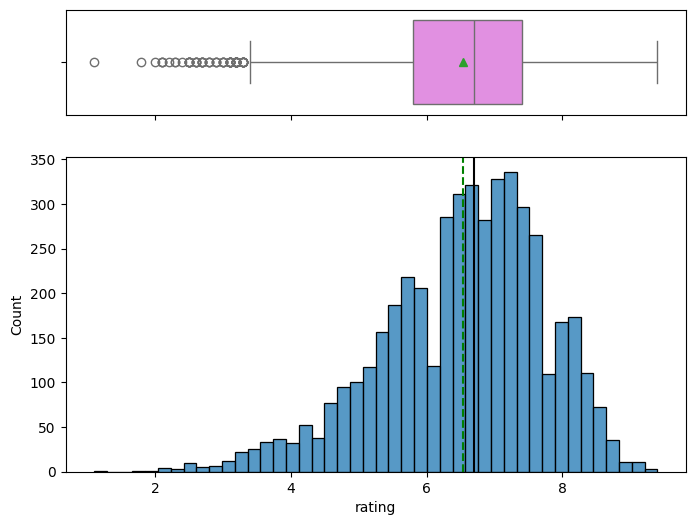

In [48]:
#visualize column histogram and distribution
histogram_boxplot(df,'rating')

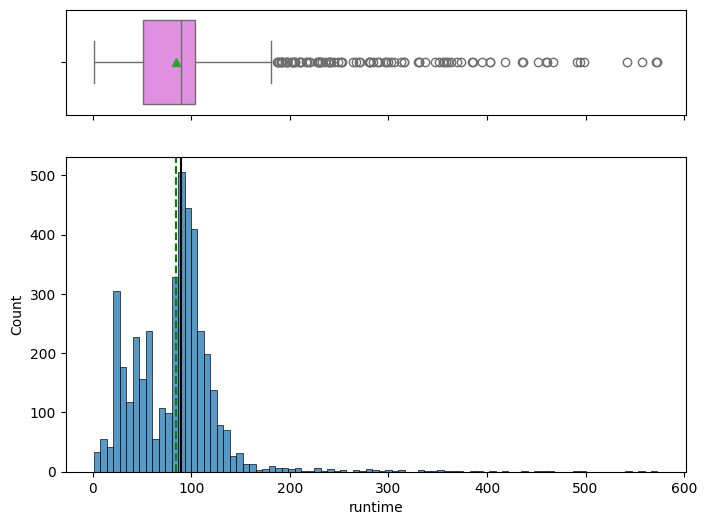

In [49]:
#visualize column histogram and distribution
histogram_boxplot(df,'runtime')

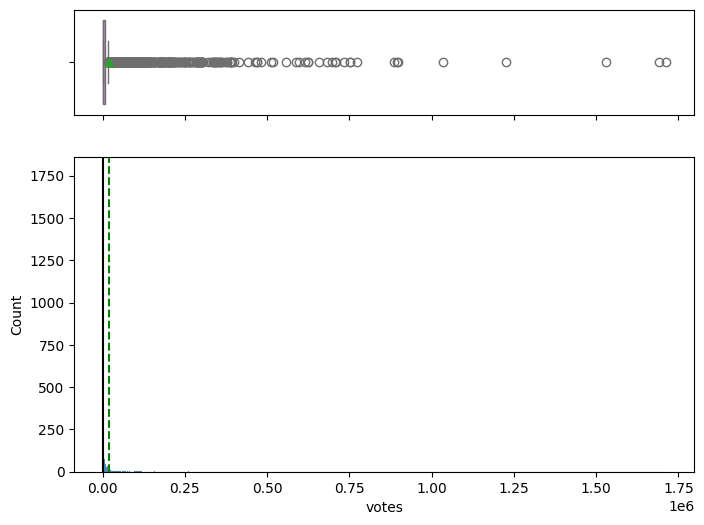

In [50]:
#visualize column histogram and distribution
histogram_boxplot(df,'votes')

labeled barplots (numeric, discrete, integer)

In [51]:
# function to create labeled barplots for univariate analysis
def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 2, 6))
    else:
        plt.figure(figsize=(n + 2, 6))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n],
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    plt.show()  # show the plot

<ipython-input-51-d1674c2aa1e9>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(


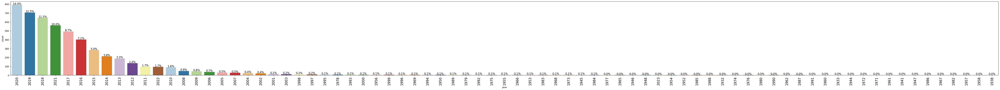

In [52]:
#visualize column bar graph
labeled_barplot(df,'year',perc=True)

<ipython-input-51-d1674c2aa1e9>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(


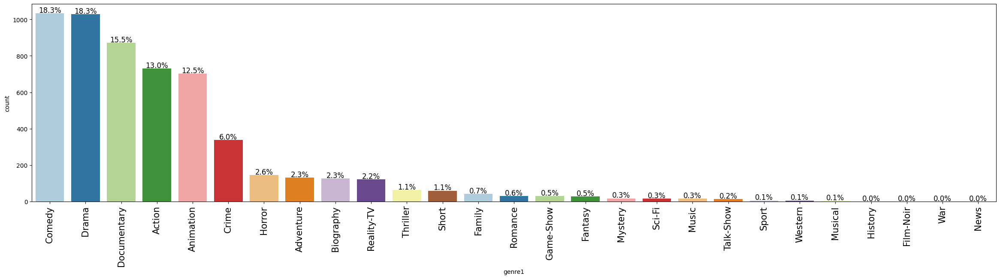

In [53]:
#visualize column bar graph
labeled_barplot(df,'genre1',perc=True)

<ipython-input-51-d1674c2aa1e9>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(


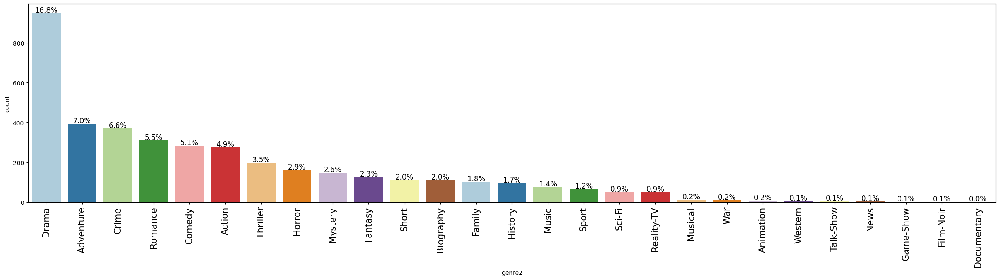

In [54]:
#visualize column bar graph
labeled_barplot(df,'genre2',perc=True)

<ipython-input-51-d1674c2aa1e9>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(


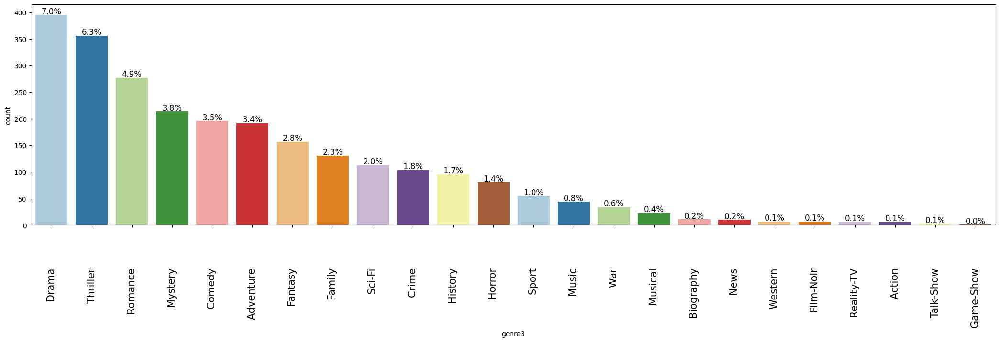

In [55]:
#visualize column bar graph
labeled_barplot(df,'genre3',perc=True)

find all outliers in a column and percentage of outliers

In [56]:
# find the number of outliers in the column

Q1inc = df['rating'].quantile(0.25)  # First quartile (25th percentile)
Q3inc = df['rating'].quantile(0.75)  # Third quartile (75th percentile)
IQRinc = Q3inc - Q1inc  # Interquartile range

lower_bound_inc = Q1inc - 1.5 * IQRinc  # Lower outlier bound
upper_bound_inc = Q3inc + 1.5 * IQRinc # Upper outlier bound

outlier_count_inc = (df['rating'] < lower_bound_inc) | (df['rating'] > upper_bound_inc)
outlier_count_inc = outlier_count_inc.sum()  # Number of outliers

print("Number of outliers in 'rating' column:", outlier_count_inc)

Number of outliers in 'rating' column: 65


In [57]:
# find percentages of outliers in the column
percentage_outlier_inc = ((outlier_count_inc)/(df.shape[0])) * 100
percentage_outlier_inc

1.1545293072824157

In [58]:
# find the number of outliers in the column

Q1inc = df['runtime'].quantile(0.25)  # First quartile (25th percentile)
Q3inc = df['runtime'].quantile(0.75)  # Third quartile (75th percentile)
IQRinc = Q3inc - Q1inc  # Interquartile range

lower_bound_inc = Q1inc - 1.5 * IQRinc  # Lower outlier bound
upper_bound_inc = Q3inc + 1.5 * IQRinc # Upper outlier bound

outlier_count_inc = (df['runtime'] < lower_bound_inc) | (df['runtime'] > upper_bound_inc)
outlier_count_inc = outlier_count_inc.sum()  # Number of outliers

print("Number of outliers in 'runtime' column:", outlier_count_inc)

Number of outliers in 'runtime' column: 96


In [59]:
# find percentages of outliers in the column
percentage_outlier_inc = ((outlier_count_inc)/(df.shape[0])) * 100
percentage_outlier_inc

1.7051509769094138

In [60]:
# find the number of outliers in the column

Q1inc = df['votes'].quantile(0.25)  # First quartile (25th percentile)
Q3inc = df['votes'].quantile(0.75)  # Third quartile (75th percentile)
IQRinc = Q3inc - Q1inc  # Interquartile range

lower_bound_inc = Q1inc - 1.5 * IQRinc  # Lower outlier bound
upper_bound_inc = Q3inc + 1.5 * IQRinc # Upper outlier bound

outlier_count_inc = (df['votes'] < lower_bound_inc) | (df['votes'] > upper_bound_inc)
outlier_count_inc = outlier_count_inc.sum()  # Number of outliers

print("Number of outliers in 'votes' column:", outlier_count_inc)

Number of outliers in 'votes' column: 731


In [61]:
# find percentages of outliers in the column
percentage_outlier_inc = ((outlier_count_inc)/(df.shape[0])) * 100
percentage_outlier_inc

12.984014209591473

In [62]:
#check over cleaned dataframe
df

,movies,year,rating,oneline,stars,votes,runtime,genre1,genre2,genre3
0,Blood Red Sky,2021,6.100,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,21062.000,121.000,Action,Horror,Thriller
1,Masters of the Universe: Revelation,2021,5.000,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...",17870.000,25.000,Animation,Action,Adventure
2,Rick and Morty,2013,9.200,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...",414849.000,23.000,Animation,Adventure,Comedy
3,Army of Thieves,2021,NaN,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,NaN,NaN,Action,Crime,Horror
4,Outer Banks,2020,7.600,A group of teenagers from the wrong side of th...,"Stars:Chase Stokes, Madelyn Cl...",25858.000,50.000,Action,Crime,Drama
5,The Last Letter from Your Lover,2021,6.800,A pair of interwoven stories set in the past a...,Director:Augustine Frizzell| Stars:Sha...,5283.000,110.000,Drama,Romance,None
6,Never Have I Ever,2020,7.900,The complicated life of a modern-day first gen...,"Stars:Maitreyi Ramakrishnan, P...",34530.000,30.000,Comedy,None,None
7,Virgin River,2019,7.400,"Seeking a fresh start, nurse practitioner Meli...","Stars:Alexandra Breckenridge, ...",27279.000,44.000,Drama,Romance,None
8,Gunpowder Milkshake,2021,6.000,Three generations of women fight back against ...,Director:Navot Papushado| Stars:Karen ...,17989.000,114.000,Action,Adventure,Thriller
9,Fear Street: 1994,2021,6.200,A circle of teenage friends accidentally encou...,Director:Leigh Janiak| Stars:Kiana Mad...,50148.000,107.000,Drama,Horror,Mystery


In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5630 entries, 0 to 5629
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   movies   5630 non-null   object 
 1   year     5102 non-null   object 
 2   rating   4676 non-null   float64
 3   oneline  5314 non-null   object 
 4   stars    5319 non-null   object 
 5   votes    4676 non-null   float64
 6   runtime  4224 non-null   float64
 7   genre1   5572 non-null   object 
 8   genre2   3949 non-null   object 
 9   genre3   2519 non-null   object 
dtypes: float64(3), object(7)
memory usage: 440.0+ KB


# save to csv file

In [64]:
## Exporting the data frame to a '.csv' file
df.to_csv('cleaned_movies_dataset.csv',index=True)